In [60]:
import numpy as np
import rasterio
from rasterio.features import shapes
import shapely
from shapely.geometry import Polygon, mapping, shape, MultiPolygon
import fiona
from fiona.crs import from_epsg
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from rasterio.plot import show, show_hist
import pandas as pd
import geopandas as gpd
import glob
import warnings
import pickle
import affine
from affine import Affine
import os
from pyproj import CRS

In [61]:
#carpeta de datos
datapath= "./data/"

In [62]:
# Guardar una lista de cadenas en un archivo de texto
def guardar_lista_en_archivo(lista, nombre_archivo):
    with open(nombre_archivo, 'w') as archivo:
        for elemento in lista:
            archivo.write(elemento + '\n')

# Leer una lista de cadenas desde un archivo de texto
def leer_lista_desde_archivo(nombre_archivo):
    lista = []
    with open(nombre_archivo, 'r') as archivo:
        for linea in archivo:
            lista.append(linea.strip())  # Eliminar el salto de línea
    return lista

In [63]:
# dados dos geopandas gdf1 y gdf2 se queda con los poligonos de la intereseccion
# gdf1: hisup
# gdf2= meta
# t: umbral de interseccion en m^2, 5 default

def hisupmeta(gdf1,gdf2,t=5):

    # explode los multipol
    #gdf1 = gdf1.explode(index_parts= True)
    #gdf2 = gdf2.explode(index_parts= True)
    
    intersection = gpd.overlay(gdf1, gdf2, how='intersection',keep_geom_type=True)
    intersection = intersection.explode(index_parts=True)
    intersection['Area']=intersection.area
    # filtro de la interseccion todo aquello con area menor a t
    intersection=intersection[intersection['Area']>t]

    #filtro con la interseccion
    filtered_polygons = []
    for index, polygon in  gdf2.iterrows():
        intersecting_polygons = intersection[intersection.intersects(polygon['geometry'])]
        if not intersecting_polygons.empty:
            filtered_polygons.append(polygon)

    # Crea el nuevo GeoDataFrame
    gdf3 = gpd.GeoDataFrame(filtered_polygons)

    # Crea una nueva columna para indicar si el polígono está contenido dentro de otro polígono
    gdf4 = gdf3.copy()
    gdf4['esta_contenido'] = False

    # Itera sobre cada polígono y verifica si está contenido en otro polígono
    for i, row in gdf4.iterrows():
        for j, inner_row in gdf4.iterrows():
            if i != j and row.geometry.within(inner_row.geometry):
                gdf4.at[i, 'esta_contenido'] = True
                break

    # Filtra el GeoDataFrame para mantener solo los polígonos que no están contenidos dentro de otros polígonos
    gdf4 = gdf4[~gdf4['esta_contenido']]

    # Elimina la columna "esta_contenido" si ya no se necesita
    gdf4 = gdf4.drop(columns='esta_contenido')

    return gdf4

In [67]:
#ler los geopandas de hisup georefernciados
# leer los geopandas trasnformados
# Ruta completa de la carpeta que se creará
ruta_completa = os.path.join(datapath, 'hisup_tr/')
archivos_hisup = sorted([f for f in os.listdir(ruta_completa) if f.endswith(".shp")])

# las dos listas estan indexadas de tal forma que corresponden a la info de la misma foto
hisup_list = []

for archivo  in archivos_hisup:
    ruta_archivo = os.path.join(ruta_completa, archivo)

    gdf_hisup = gpd.read_file(ruta_archivo)
    hisup_list.append(gdf_hisup)


#leer el archivo de poligonos vacios
empty = leer_lista_desde_archivo(ruta_completa+'empty.txt')

In [65]:
len(archivos_hisup)

28

In [123]:
#leer los geopandas de meta georefernciados
# leer los geopandas trasnformados
# Ruta completa de la carpeta que se creará
ruta_completa = os.path.join(datapath, 'gdf_meta/')
archivos_meta = sorted([f for f in os.listdir(ruta_completa) if f.endswith(".shp")])

# las dos listas estan indexadas de tal forma que corresponden a la info de la misma foto
meta_list = []
# hay que eliminar de meta el polígono que da vacio en hisup
base = empty[0].split('.tif')[0]
elemento_a_eliminar = 'gdf_' + base + '.shp'
#remover el elemento de la lista    
archivos_meta.remove(elemento_a_eliminar)

for archivo  in archivos_meta:
    ruta_archivo = os.path.join(ruta_completa, archivo)

    gdf_meta = gpd.read_file(ruta_archivo)
    gdf_meta = gdf_meta.explode(index_parts= True)
    meta_list.append(gdf_meta)

In [130]:
# guardar los poligonos intersectados
ruta_completa = os.path.join(datapath, 'hisupmeta/')

# Crear la carpeta en el directorio especificado
os.makedirs(ruta_completa, exist_ok=True)

for n in range(len(hisup_list)):
    gdf = hisupmeta(hisup_list[n],meta_list[n])
    nombre_archivo = archivos_meta[n].split('.shp')[0]
    nombre_completo = os.path.join(ruta_completa, 'hisupmeta_' + nombre_archivo + ".shp")
    gdf.to_file(nombre_completo)

In [137]:
#leer los geopandas intersectados
ruta_completa = os.path.join(datapath, 'hisupmeta/')
archivos_hisupmeta = sorted([f for f in os.listdir(ruta_completa) if f.endswith(".shp")])

hisupmeta_list=[]

for archivo  in archivos_hisupmeta:
    ruta_archivo = os.path.join(ruta_completa, archivo)

    gdf_hisupmeta = gpd.read_file(ruta_archivo)
    #gdf_meta = gdf_meta.explode(index_parts= True)
    gdf_hisupmeta['Area'] = gdf_hisupmeta.area
    hisupmeta_list.append(gdf_hisupmeta)



In [133]:
#leer los tifs salvo los que tienen poligono de hisup vacio
ortho_files= sorted([f for f in os.listdir(datapath+'recorte_B2124/') if f.endswith(".tif")])
set1 = set(ortho_files)
set2= set(empty)
dif = sorted(set1 - set2)
ortho_files = list(dif)   

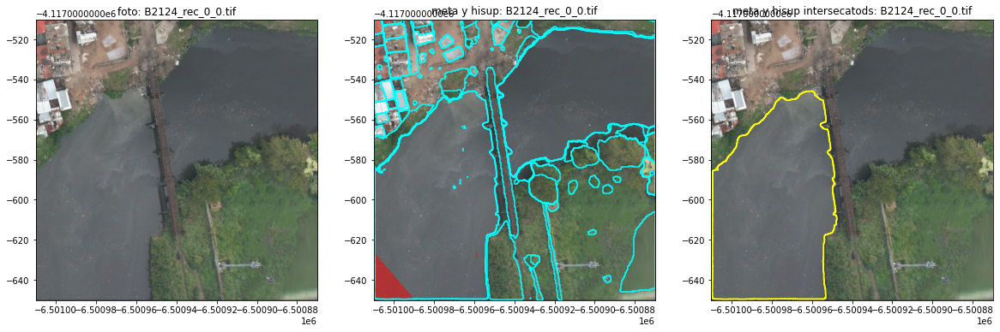

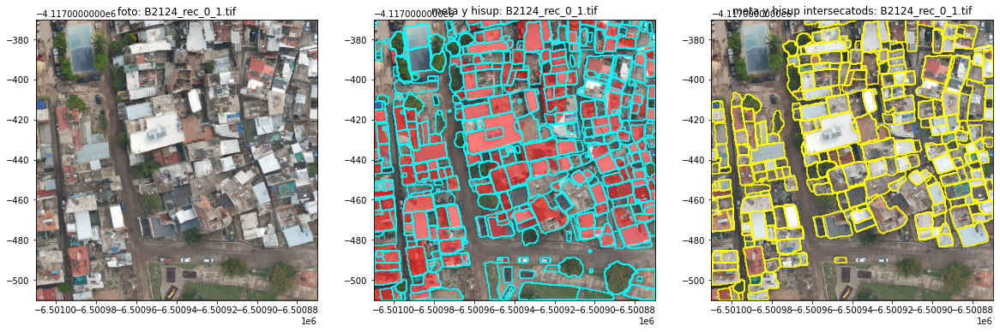

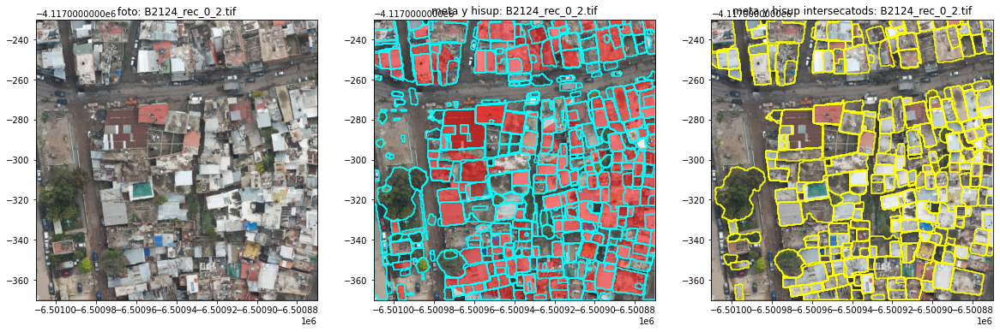

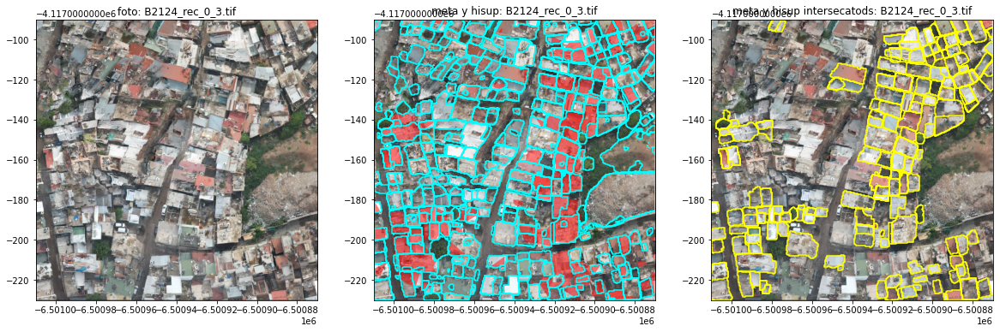

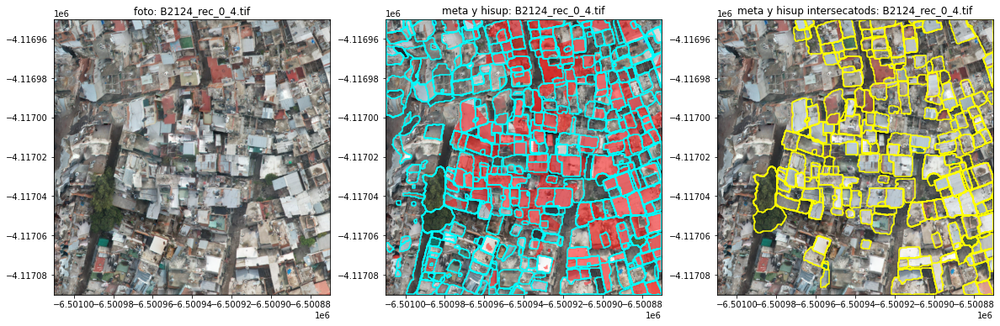

...

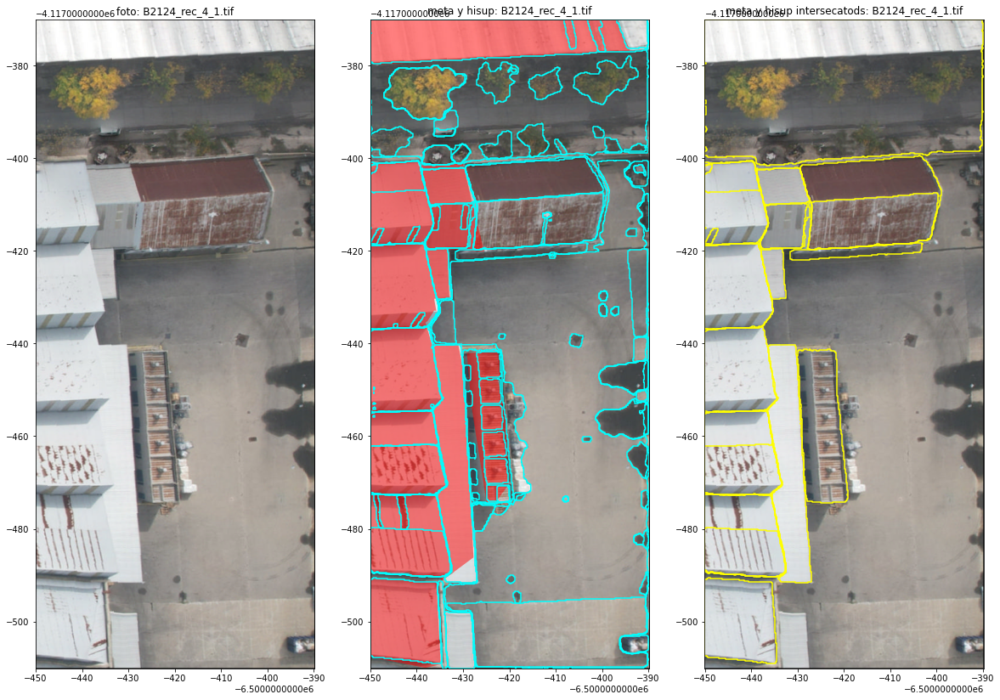

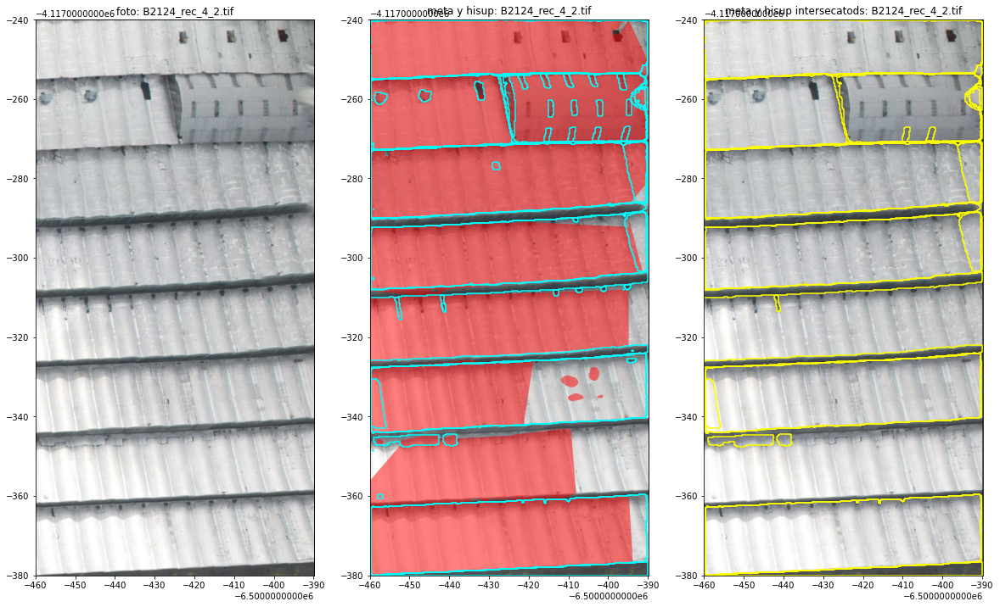

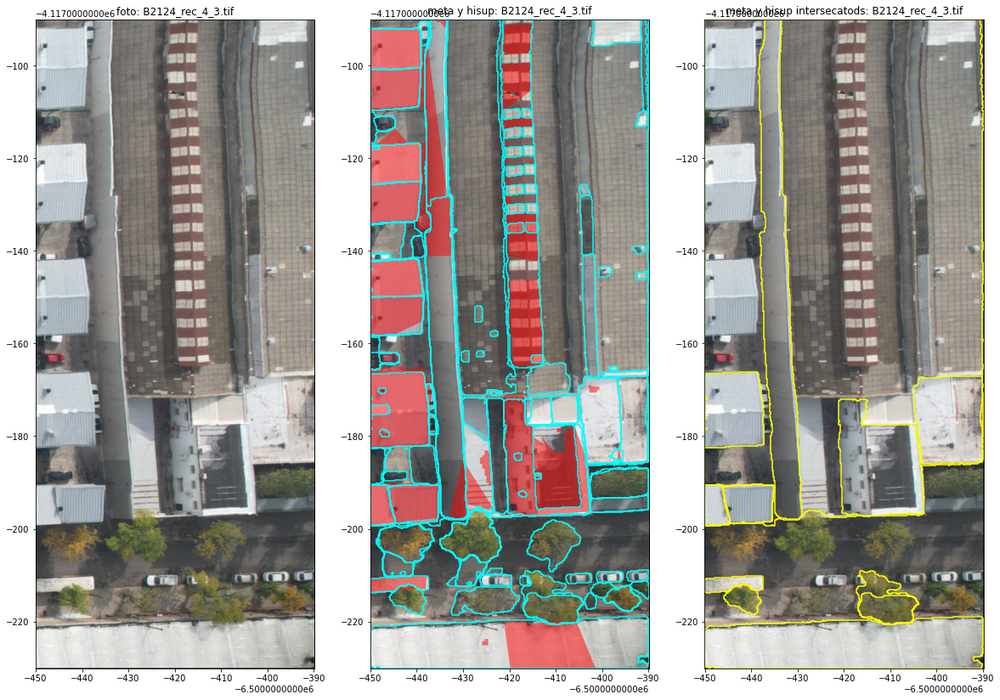

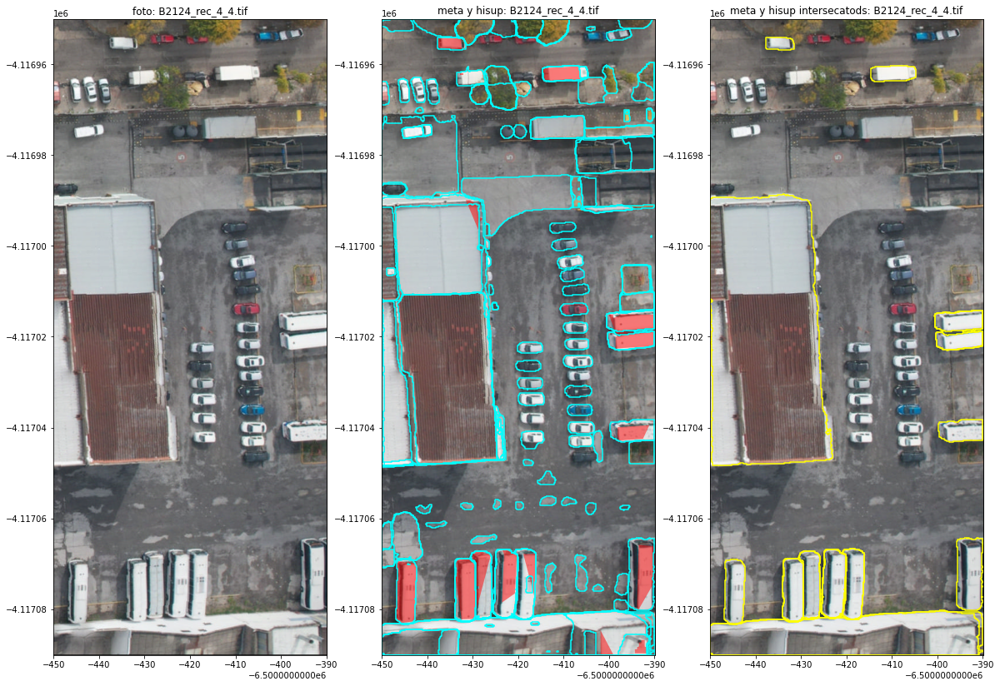

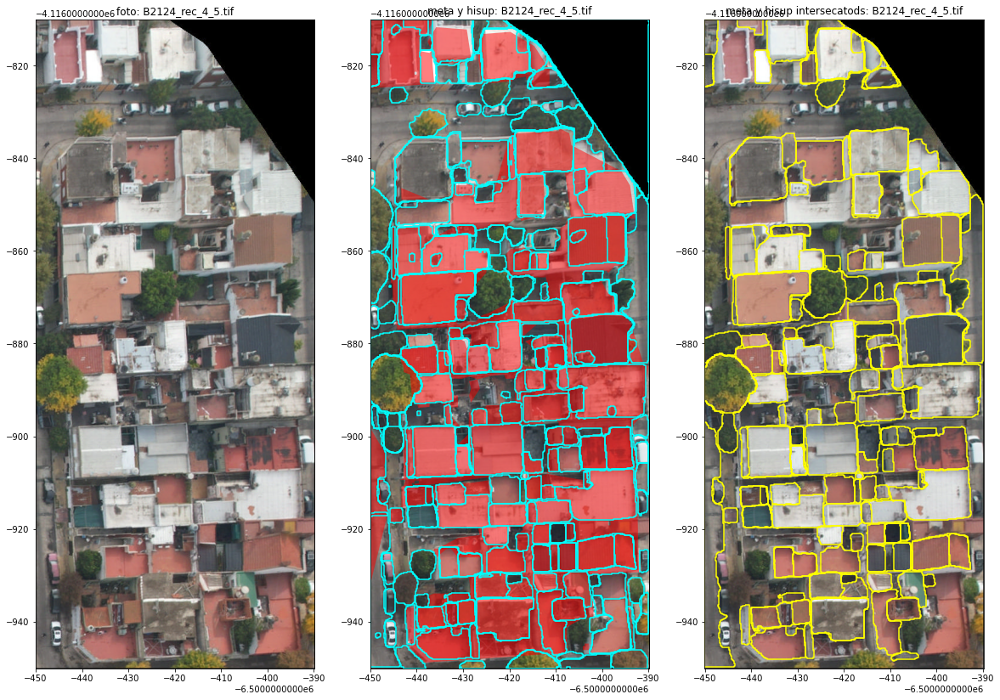

In [152]:
#dibujar los poligonos con la foto
#
ruta_completa = os.path.join(datapath, 'plots_int/')
# Crear la carpeta en el directorio especificado
os.makedirs(ruta_completa, exist_ok=True)

for n in range(len(ortho_files)): 
    ortho = rasterio.open(datapath+'hisup_data/'+ortho_files[n])

    fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(20, 20))
    
    # tif
    ax1.set_title('foto: '+ortho_files[n])
    show(ortho, ax=ax1)

    # meta y hisup
    ax2.set_title('meta y hisup: '+ortho_files[n])
    show(ortho, ax=ax2)
    hisup_list[n].plot(ax=ax2, color='red',alpha=0.5)
    meta_list[n].boundary.plot(ax=ax2, color='cyan')


    # meta y hisup intersectados
    ax3.set_title('meta y hisup intersecatods: '+ortho_files[n])
    show(ortho, ax=ax3)
    hisupmeta_list[n].boundary.plot(ax=ax3, color='yellow')

     # guardo el plot
    plt.savefig(ruta_completa+"plot_"+ ortho_files[n]+ ".png")

    plt.show()

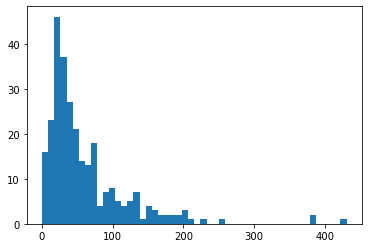

In [147]:
plt.hist(hisupmeta_list[2]['Area'], bins=50)
plt.show()